In [1]:
import pandas as pd
import tensorflow as tf
import csv
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import seaborn as sns
from sklearn import linear_model
!pip install dataprep
from dataprep.eda import create_report

     |████████████████████████████████| 1.8MB 7.6MB/s 
     |████████████████████████████████| 1.5MB 36.8MB/s 
     |████████████████████████████████| 1.3MB 41.2MB/s 
     |████████████████████████████████| 51kB 6.1MB/s 
     |████████████████████████████████| 71kB 8.7MB/s 
     |████████████████████████████████| 727kB 32.5MB/s 
     |████████████████████████████████| 81kB 9.4MB/s 
     |████████████████████████████████| 368kB 35.3MB/s 
     |████████████████████████████████| 10.1MB 41.8MB/s 
     |████████████████████████████████| 849kB 41.5MB/s 
     |████████████████████████████████| 296kB 48.8MB/s 
     |████████████████████████████████| 143kB 45.2MB/s 
     |████████████████████████████████| 747kB 26.5MB/s 
     |████████████████████████████████| 51kB 6.2MB/s 
     |████████████████████████████████| 112kB 54.5MB/s 
  Created wheel for python-Levenshtein: filename=python_Levenshtein-0.12.2-cp37-cp37m-linux_x86_64.whl size=149809 sha256=1790ef3b7565f0a34ff345e597de63158ce36a85c49130

NumExpr defaulting to 2 threads.


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Data load

In [4]:
train = pd.read_csv('/content/drive/MyDrive/kaggle/FebTabular/train.csv')

test = pd.read_csv('/content/drive/MyDrive/kaggle/FebTabular/test.csv')

In [5]:
train

,id,cat0,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,cat9,cont0,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,target
0,1,A,B,A,A,B,D,A,E,C,I,0.923191,0.684968,0.124454,0.217886,0.281421,0.881122,0.421650,0.741413,0.895799,0.802461,0.724417,0.701915,0.877618,0.719903,6.994023
1,2,B,A,A,A,B,B,A,E,A,F,0.437627,0.014213,0.357438,0.846127,0.282354,0.440011,0.346230,0.278495,0.593413,0.546056,0.613252,0.741289,0.326679,0.808464,8.071256
2,3,A,A,A,C,B,D,A,B,C,N,0.732209,0.760122,0.454644,0.812990,0.293756,0.914155,0.369602,0.832564,0.865620,0.825251,0.264104,0.695561,0.869133,0.828352,5.760456
3,4,A,A,A,C,B,D,A,E,G,K,0.705142,0.771678,0.153735,0.732893,0.769785,0.934138,0.578930,0.407313,0.868099,0.794402,0.494269,0.698125,0.809799,0.614766,7.806457
4,6,A,B,A,A,B,B,A,E,C,F,0.486063,0.639349,0.496212,0.354186,0.279105,0.382600,0.705940,0.325193,0.440967,0.462146,0.724447,0.683073,0.343457,0.297743,6.868974
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299995,499993,A,B,A,C,B,B,A,E,E,L,0.260716,0.712438,0.161661,0.442794,0.768447,0.269578,0.258655,0.363598,0.300619,0.340516,0.235711,0.383477,0.215227,0.793630,8.343538
299996,499996,A,B,A,C,B,B,A,E,E,L,0.173302,0.121591,0.592514,0.193711,0.775951,0.197211,0.257024,0.574304,0.227035,0.322583,0.286094,0.324874,0.306933,0.230902,7.851861
299997,499997,A,B,A,C,B,B,A,E,C,M,0.342856,0.617869,0.462991,0.418098,0.297406,0.449482,0.386172,0.476217,0.135947,0.502730,0.235788,0.316671,0.250286,0.349041,7.600558
299998,499998,A,B,B,C,B,B,A,D,E,F,0.599403,0.686054,0.660860,0.187199,0.758642,0.363130,0.324132,0.229017,0.220888,0.515304,0.389391,0.245234,0.303895,0.481138,8.272095


### EDA

DataPrep Report
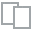
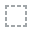
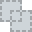
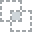
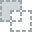
...
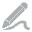
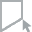
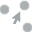
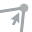
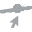

In [6]:
create_report(train)

### Label Encoding

In [7]:
from sklearn.preprocessing import LabelEncoder

In [8]:
def Label_Encoding(data):
    label_encoder = LabelEncoder()
    for i in range(0,10):        
        data["cat%d" %i] =label_encoder.fit_transform(data["cat%d" %i])
             
    return data

In [13]:
train = Label_Encoding(train)
test = Label_Encoding(test)

### Modeling

In [14]:
PREDICTORS = ["cat%d" %i for i in range(0,10)] + ["cont%d" %i for i in range(0,14)] 
TARGET = ["target"]


In [11]:
def apply_linear_regression(train,test):
    alg = LinearRegression()
    alg.fit(train[PREDICTORS],train[TARGET])
    print(alg.intercept_,alg.coef_)
    
    predictions = alg.predict(test[PREDICTORS])
        
    output = pd.DataFrame({
        "id": test["id"],
        "target" : predictions[:,0].astype(float)
    })
    output.to_csv("FebTabular_submission.csv",index = False)

In [15]:
apply_linear_regression(train,test)

[7.33325216] [[-0.16062387  0.20182508  0.26101646  0.04134838  0.00480249  0.01346155
   0.1663228  -0.02900503 -0.01323771  0.00477908 -0.33759618  0.17066824
   0.00736902 -0.02286544 -0.05605497 -0.2553378   0.10296063  0.11619033
   0.2721751   0.05693459 -0.16523998  0.1909936   0.05159559 -0.00599478]]
